# Reproducing Gunseli CDA Study (2019) - Channels

## Notes

In [1]:
import glob
import pickle
import pandas as pd
import numpy as np
import copy

import mne
from mne import Epochs, pick_channels, find_events
from mne.io import read_raw_eeglab

import sys
#sys.path.append('/Users/nick/Documents/PhD/CLCT/reprod/studies/')
sys.path.append('D:\\PhD\\CDA-review\\studies\\')
from cda_utils import get_epochs, get_CDA, prep_report, fill_report, get_report, checksum, add_cda_report, get_CDA_perf_report
#sys.path.append('/Users/nick/Documents/PhD/CLCT/reprod/studies/Gunseli-2019/')
sys.path.append('D:\\PhD\\CDA-review\\studies\\Gunseli-2019\\')
from events import get_specific_events

import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline

## 1. Prep Data

In [2]:
#==================================================================
# General Variables
#==================================================================
study_id = 'Gunseli2019'

triggers = dict();

triggers['80% valid'] = [5] 
triggers['50% valid'] = [6]

triggers['left'] = [10]
triggers['right'] = [20]
triggers['TBD'] = [30, 255]  # 255 is only for pp24 which doesn't have '30' but '255'

triggers['good'] = []
triggers['bad'] = []

# Labels
conds = ['80% valid', '50% valid']
sides = ['left', 'right', 'TBD']
perfs = ['good', 'bad']

# Internal Triggers to Epochs Properly
internal_triggers = dict()
internal_triggers_count = 0
for cond in conds:
    for side in sides:
        for perf in perfs:
            internal_triggers_count = internal_triggers_count + 1
            internal_triggers['{}-{}-{}'.format(cond,side,perf)] = internal_triggers_count
            
# CDA Channels
chan_right = ['P8', 'PO8', 'O2']
chan_left = ['P7', 'PO7', 'O1']

# Epoch Information
epoch_length = 1.2
epoch_tmin = -0.2
baseline_corr = (-0.2, 0)

# CDA info
cda_window = (0.4, 0.9)

# CDA main variable!
cda_dict_all = dict()
epochs_dict_all = dict()
perf_report_all = dict()
report = prep_report(conds, sides, perfs)

#==================================================================
# Main Loop - Loading All Files & Extract CDAs.
#==================================================================
#folderpath = '/Users/nick/Documents/PhD/CDA Datasets/Gunseli 2019/'
folderpath = 'D:\\CLNT\\Data\\Open Datasets\\Gunseli 2019\\'
sep = '\\'

#filepath = folderpath + 'raw data files/' + 'StratAtt_e2_LoadChans_pp11.set'

for filepath in glob.iglob(folderpath + 'raw data files/' + '*.set'):
    filename = filepath[filepath.rfind(sep)+1:]
    print('Processing: ' + filename + '...')

    # ------------------------
    # 1. -- Load File --
    # ------------------------
    raw = read_raw_eeglab(filepath, preload=True)

    # ------------------------
    # 2. -- Preprocessing --
    # ------------------------
    # Set Electrodes Locations - Used Brain Products (locations seem to in eeg file...)
    montage = mne.channels.make_standard_montage('biosemi64')
    raw.set_montage(montage)

    preproc = raw.resample(500)

    # Filter
    preproc = preproc.filter(.1, 20., fir_design='firwin', skip_by_annotation='edge')

    # Events
    events = mne.events_from_annotations(preproc)

    # Select Channels (to save time on cleaning)
    #preproc = preproc.pick_channels(chan_right + chan_left)

    # Plot (visual check)
    #preproc.plot(events=events, block=True, lowpass=40)

    # ------------------------
    # 3. -- Epochs --
    # ------------------------
    # Redo Triggers based on annotation in file!
    new_triggers = copy.deepcopy(triggers)
    for k in new_triggers.keys():
        for i,t in enumerate(new_triggers[k]):
            if str(t) in events[1].keys():
                new_triggers[k][i] = events[1][str(t)]
    specific_events = get_specific_events(events[0], conds, sides, perfs, new_triggers, internal_triggers)

    epochs_dict = get_epochs(preproc, specific_events, epoch_length, epoch_tmin, baseline_corr, clean=False)

    epochs_dict_all[filename] = epochs_dict

    # times, used for CDA mean amp report.
    times = epochs_dict[conds[0]][sides[0]][perfs[0]].times
    
    # ------------------------
    # 4. - Report & Checksum -
    # ------------------------
    report = fill_report(report, filename, specific_events)
    #report = add_cda_report(report, filename, conds, sides, perfs, cda_dict_all[filename], times, cda_window=cda_window)
    report.at[filename, 'checksum'] = checksum(specific_events, epochs_dict)

    perf_report_all[filename] = get_CDA_perf_report(epochs_dict, conds, sides, perfs, chan_right, chan_left, cda_window=cda_window)

# Print report
print('{} Subjects & {} Trials'.format(len(report), 2*np.sum([report[cond].sum() for cond in conds])))
report

Processing: StratAtt_e2_LoadChans_pp10.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp10.fdt
Reading 0 ... 2025983  =      0.000 ...  3956.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp11.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp11.fdt
Reading 0 ... 2301951  =      0.000 ...  4495.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp12.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp12.fdt
Reading 0 ... 2461183  =      0.000 ...  4806.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 474 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
474 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 474 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 474 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp13.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp13.fdt
Reading 0 ... 2625023  =      0.000 ...  5126.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp14.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp14.fdt
Reading 0 ... 1984511  =      0.000 ...  3875.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp15.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp15.fdt
Reading 0 ... 2398207  =      0.000 ...  4683.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp16.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp16.fdt
Reading 0 ... 2191359  =      0.000 ...  4279.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp17.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp17.fdt
Reading 0 ... 2014207  =      0.000 ...  3933.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp18.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp18.fdt
Reading 0 ... 2211327  =      0.000 ...  4318.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp19.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp19.fdt
Reading 0 ... 2246143  =      0.000 ...  4386.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp2.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp2.fdt
Reading 0 ... 2452479  =      0.000 ...  4789.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp21.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp21.fdt
Reading 0 ... 2441727  =      0.000 ...  4768.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp22.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp22.fdt
Reading 0 ... 2147327  =      0.000 ...  4193.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp23.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp23.fdt
Reading 0 ... 2717695  =      0.000 ...  5307.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp24.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp24.fdt
Reading 0 ... 2158079  =      0.000 ...  4214.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '255', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...

D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp25.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp25.fdt
Reading 0 ... 2459135  =      0.000 ...  4802.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp26.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp26.fdt
Reading 0 ... 2140671  =      0.000 ...  4180.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp28.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp28.fdt
Reading 0 ... 2721279  =      0.000 ...  5314.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp29.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp29.fdt
Reading 0 ... 2338303  =      0.000 ...  4566.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Data file name in EEG.data (StratAtt_e2_LoadChans_pp29set.fdt) is incorrect, the file name must have changed on disk, using the correct file name (StratAtt_e2_LoadChans_pp29.fdt).
  raw = read_raw_eeglab(filepath, preload=True)
<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp3.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp3.fdt
Reading 0 ... 2164223  =      0.000 ...  4226.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp30.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp30.fdt
Reading 0 ... 1821695  =      0.000 ...  3557.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: The data contains 'boundary' events, indicating data discontinuities. Be cautious of filtering and epoching around these events.
  raw = read_raw_eeglab(filepath, preload=True)
<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6', 'boundary']
Total: 489 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
489 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 489 events and 701 original time point

D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 489 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp31.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp31.fdt
Reading 0 ... 2464255  =      0.000 ...  4812.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp32.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp32.fdt
Reading 0 ... 2401279  =      0.000 ...  4689.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp33.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp33.fdt
Reading 0 ... 2573311  =      0.000 ...  5025.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp4.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp4.fdt
Reading 0 ... 2206207  =      0.000 ...  4308.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 490 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
490 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 490 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 490 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp5.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp5.fdt
Reading 0 ... 2381311  =      0.000 ...  4650.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp6.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp6.fdt
Reading 0 ... 2693631  =      0.000 ...  5260.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp7.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp7.fdt
Reading 0 ... 2332671  =      0.000 ...  4555.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp8.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp8.fdt
Reading 0 ... 2351103  =      0.000 ...  4591.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
Processing: StratAtt_e2_LoadChans_pp9.set...
Reading D:\CLNT\Data\Open Datasets\Gunseli 2019\raw data files\StratAtt_e2_LoadChans_pp9.fdt
Reading 0 ... 2471423  =      0.000 ...  4826.998 secs...


<ipython-input-2-2d7f8a2fc941>:66: RuntimeWarning: Not setting positions of 4 eog channels found in montage:
['VEOGsT', 'VEOGsB', 'HEOGsL', 'HEOGsR']
Consider setting the channel types to be of EEG/sEEG/ECoG/DBS/fNIRS using inst.set_channel_types before calling inst.set_montage, or omit these channels when creating your montage.
  raw = read_raw_eeglab(filepath, preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 16501 samples (33.002 sec)

Used Annotations descriptions: ['1', '10', '20', '30', '5', '6']
Total: 500 (0 Skipped do to overlapping events with missing triggers.)
====================== EPOCHING ======================
tmin:-0.2, tmax:1.2, baseline=(-0.2, 0)
Not setting metadata
500 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 500 events and 701 original time points ...


D:\PhD\CDA-review\studies\cda_utils.py:40: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  all_epochs = Epochs(eeg, all_events, tmin=epoch_tmin, tmax=epoch_length, baseline=baseline_corr, preload=True, event_repeated='merge')


0 bad epochs dropped
A total of 500 epochs were extracted and baseline corrected.
---------- 80% valid-left-good -------------
---------- 80% valid-left-bad -------------
---------- 80% valid-right-good -------------
---------- 80% valid-right-bad -------------
---------- 80% valid-TBD-good -------------
---------- 80% valid-TBD-bad -------------
---------- 50% valid-left-good -------------
---------- 50% valid-left-bad -------------
---------- 50% valid-right-good -------------
---------- 50% valid-right-bad -------------
---------- 50% valid-TBD-good -------------
---------- 50% valid-TBD-bad -------------
====================== /EPOCHING ======================
Verifying Checksum (events vs epochs)...
Checksum all good!
30 Subjects & 29906 Trials


,80% valid,50% valid,left,right,TBD,good,bad,80% valid-left,80% valid-left-CDA,80% valid-left-good,...,50% valid-TBD,50% valid-TBD-CDA,50% valid-TBD-good,50% valid-TBD-good-CDA,TBD-good-CDA,50% valid-TBD-bad,50% valid-TBD-bad-CDA,TBD-bad-CDA,checksum,notes
StratAtt_e2_LoadChans_pp10.set,250,250,173,161,166,500,0,88,0,88,...,83,0,83,0,0,0,0,0,1,
StratAtt_e2_LoadChans_pp11.set,250,250,167,151,182,500,0,79,0,79,...,97,0,97,0,0,0,0,0,1,
StratAtt_e2_LoadChans_pp12.set,224,250,147,143,184,474,0,69,0,69,...,99,0,99,0,0,0,0,0,1,
StratAtt_e2_LoadChans_pp13.set,250,250,158,163,179,500,0,85,0,85,...,86,0,86,0,0,0,0,0,1,
StratAtt_e2_LoadChans_pp14.set,250,250,162,180,158,500,0,82,0,82,...,87,0,87,0,0,0,0,0,1,
StratAtt_e2_LoadChans_pp15.set,250,250,171,161,168,500,0,84,0,84,...,84,0,84,0,0,0,0,0,1,
StratAtt_e2_LoadChans_pp16.set,250,250,193,152,155,500,0,92,0,92,...,76,0,76,0,0,0,0,0,1,
StratAtt_e2_LoadChans_pp17.set,250,250,144,164,192,500,0,69,0,69,...,93,0,93,0,0,0,0,0,1,
StratAtt_e2_LoadChans_pp18.set,250,250,156,166,178,500,0,74,0,74,...,81,0,81,0,0,0,0,0,1,
StratAtt_e2_LoadChans_pp19.set,250,250,180,162,158,500,0,86,0,86,...,85,0,85,0,0,0,0,0,1,


In [4]:
for id in report.index:
    report.at[id, 'perf'] = int(report.at[id, 'good'] / (report.at[id, 'good'] + report.at[id, 'bad']) * 100)

top5 = (report.sort_values(by=['perf'], ascending=False)).index[0:5]
low5 = (report.sort_values(by=['perf'], ascending=False)).index[-5:]
print(top5)

report.sort_values(by=['perf'], ascending=False)

Index(['StratAtt_e2_LoadChans_pp10.set', 'StratAtt_e2_LoadChans_pp11.set',
       'StratAtt_e2_LoadChans_pp8.set', 'StratAtt_e2_LoadChans_pp7.set',
       'StratAtt_e2_LoadChans_pp6.set'],
      dtype='object')


,80% valid,50% valid,left,right,TBD,good,bad,80% valid-left,80% valid-left-CDA,80% valid-left-good,...,50% valid-TBD-CDA,50% valid-TBD-good,50% valid-TBD-good-CDA,TBD-good-CDA,50% valid-TBD-bad,50% valid-TBD-bad-CDA,TBD-bad-CDA,checksum,notes,perf
StratAtt_e2_LoadChans_pp10.set,250,250,173,161,166,500,0,88,0,88,...,0,83,0,0,0,0,0,1,,100.0
StratAtt_e2_LoadChans_pp11.set,250,250,167,151,182,500,0,79,0,79,...,0,97,0,0,0,0,0,1,,100.0
StratAtt_e2_LoadChans_pp8.set,250,250,171,169,160,500,0,85,0,85,...,0,77,0,0,0,0,0,1,,100.0
StratAtt_e2_LoadChans_pp7.set,250,250,167,186,147,500,0,85,0,85,...,0,71,0,0,0,0,0,1,,100.0
StratAtt_e2_LoadChans_pp6.set,250,250,171,163,166,500,0,88,0,88,...,0,94,0,0,0,0,0,1,,100.0
StratAtt_e2_LoadChans_pp5.set,250,250,188,140,172,500,0,99,0,99,...,0,84,0,0,0,0,0,1,,100.0
StratAtt_e2_LoadChans_pp4.set,240,250,150,171,169,490,0,65,0,65,...,0,76,0,0,0,0,0,1,,100.0
StratAtt_e2_LoadChans_pp33.set,250,250,159,177,164,500,0,84,0,84,...,0,91,0,0,0,0,0,1,,100.0
StratAtt_e2_LoadChans_pp32.set,250,250,152,183,165,500,0,76,0,76,...,0,77,0,0,0,0,0,1,,100.0
StratAtt_e2_LoadChans_pp31.set,250,250,174,153,173,500,0,83,0,83,...,0,88,0,0,0,0,0,1,,100.0


In [5]:
with open('D:\\PhD\\CDA-review\\studies\\Gunseli-2019-Channels.pkl', 'wb') as f:
    pickle.dump(epochs_dict_all, f)
    
del epochs_dict_all

In [3]:
with open('D:\\PhD\\CDA-review\\studies\\_channels\\Gunseli-2019-Channels.pkl', 'rb') as f:
    epochs_dict_all = pickle.load(f)

In [12]:
del epochs_dict_all

NameError: name 'epochs_dict_all' is not defined

## 2. Get CDA

In [4]:
# YR: Confirmed channels!
chan_left_all  = ['Fp1', 'AF7', 'AF3', 'F1', 'F3', 'F5', 'F7', 'FT7', 'FC5', 'FC3', 'FC1', 'C1', 'C3', 'C5', 'T7', 'TP7', 'CP5', 'CP3', 'CP1', 'P1', 'P3', 'P5', 'P7', 'P9', 'PO7', 'PO3', 'O1']
chan_right_all = ['Fp2', 'AF8', 'AF4', 'F2', 'F4', 'F6', 'F8', 'FT8', 'FC6', 'FC4', 'FC2', 'C2', 'C4', 'C6', 'T8', 'TP8', 'CP6', 'CP4', 'CP2', 'P2', 'P4', 'P6', 'P8', 'P10', 'PO8', 'PO4', 'O2']

cda_dict = dict()
cda_all_channels = dict()
cda_all_channels_per_subj = dict()
for f in epochs_dict_all.keys():
    cda_all_channels_per_subj[f] = dict()
    for cond in conds:
        cda_all_channels[cond] = dict()
        cda_all_channels_per_subj[f][cond] = dict()
        for perf in perfs:
            cda_all_channels[cond][perf] = dict()
            cda_all_channels_per_subj[f][cond][perf] = dict()

# Get CDA per Channel-Pair
for i, ch in enumerate(chan_right_all):
    # Get CDA for a specific Channel-Pair for all Subjects
    for filename in epochs_dict_all.keys():
        cda_dict[filename] = get_CDA(epochs_dict_all[filename], conds, sides, perfs, [chan_right_all[i]], [chan_left_all[i]])

    # For each Cond-Perf get the CDA per Channel-Pair across Subjects
    cda_all = dict()
    for cond in cda_dict[list(cda_dict.keys())[0]].keys():
        cda_all[cond] = dict()
        
        for perf in ['good']: #perfs:
            cda_all[cond][perf] = dict()

            for f in cda_dict.keys():
                if (f == 'StratAtt_e2_LoadChans_pp11.set') or (f == 'StratAtt_e2_LoadChans_pp18.set' and cond == '5') or (f == 'StratAtt_e2_LoadChans_pp24.set' and cond == '6') or (f == 'StratAtt_e2_LoadChans_pp29.set' and cond == '6'):
                    continue
                    
                ldict = cda_dict[f][cond]['left']
                rdict = cda_dict[f][cond]['right']
                if (perf in ldict.keys() and len(ldict[perf])) and (perf in rdict.keys() and len(rdict[perf])):
                    cda_dict_cur = (cda_dict[f][cond]['left'][perf] + cda_dict[f][cond]['right'][perf])/2
                    cda_all[cond][perf] = np.vstack([cda_all[cond][perf], cda_dict_cur]) if len(cda_all[cond][perf]) else cda_dict_cur
                    cda_all_channels_per_subj[f][cond][perf]["{}-{}".format(chan_left_all[i], chan_right_all[i])] = cda_dict_cur
                else:
                    print("==== SKIPPED: 0 points! (File: {} - Cond: {} - Perf: {})".format(str(f), str(cond), perf))
        
            cda_all_channels[cond][perf]["{}-{}".format(chan_left_all[i], chan_right_all[i])] = cda_all[cond][perf].mean(0)


In [5]:
times = epochs_dict_all[filename][cond]['left'][perf].times

### 2.1 Plot CDA - All Channel Pairs (Group Level / All Subjects)

### Note:

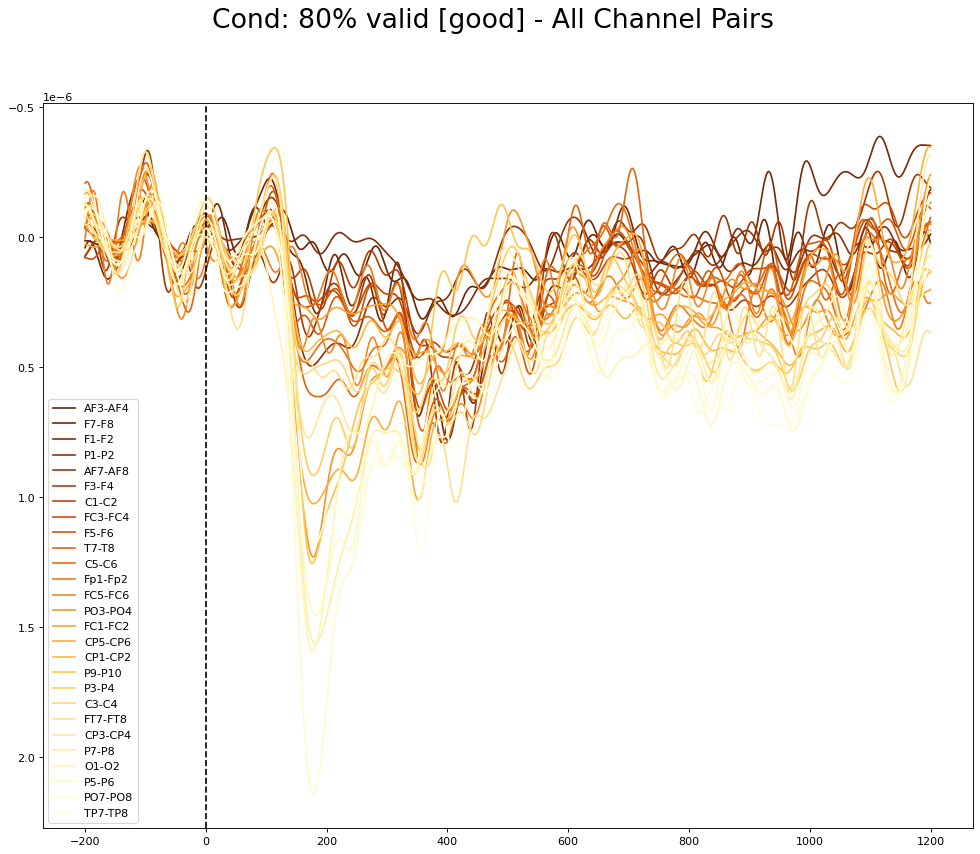

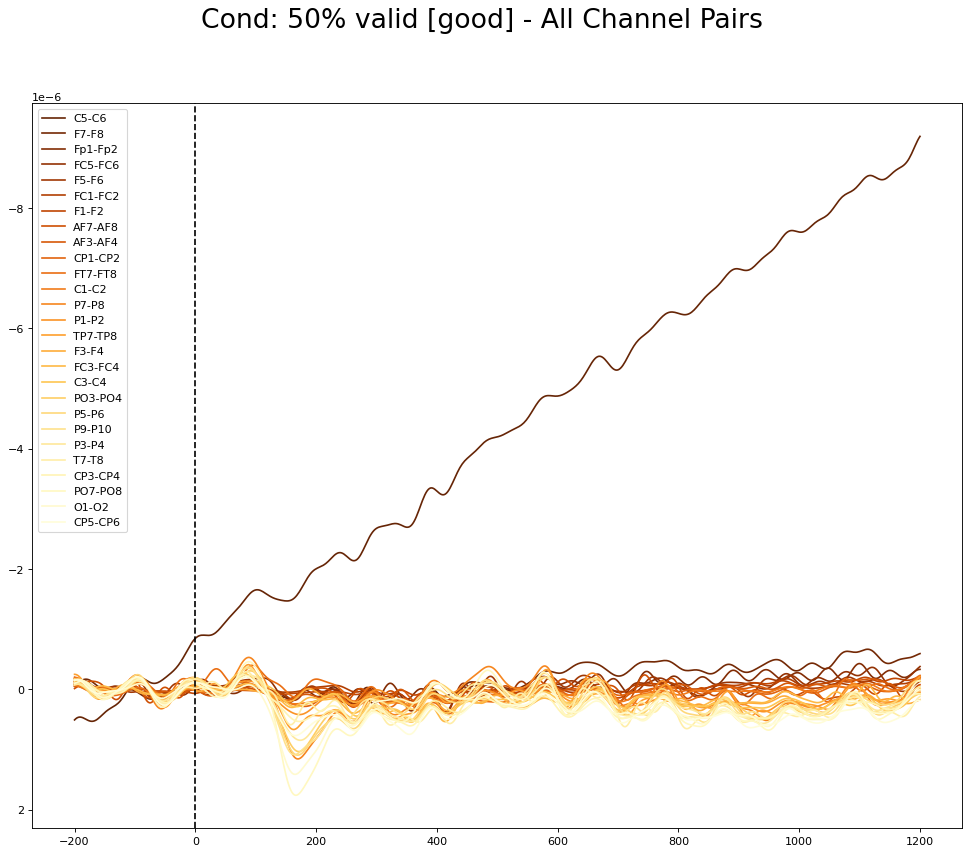

In [7]:
cmap = matplotlib.cm.get_cmap('YlOrBr')

for perf in ['good']: #perfs:
    for cond in conds:
        plt.figure(figsize=(15, 12), dpi=80)
        plt.suptitle("Cond: {} [{}] - All Channel Pairs".format(cond, perf), fontsize=24)

        ch_pair_mean_amp = [cda_all_channels[cond][perf][x].mean(0) for x in cda_all_channels[cond][perf]]
        mean_list, cda_sorted = zip(*sorted(zip(ch_pair_mean_amp, cda_all_channels[cond][perf].items())))

        nb_pairs = len(cda_all_channels[cond][perf].keys())
        for i, ch_pair in enumerate(cda_all_channels[cond][perf].keys()):
            plt.plot((times * 1000), cda_sorted[i][1], label=cda_sorted[i][0], color=cmap(1-i/nb_pairs))

        plt.axvline(x=0, color='k', linestyle='--')
        plt.gca().invert_yaxis()
        plt.legend()
        plt.show()

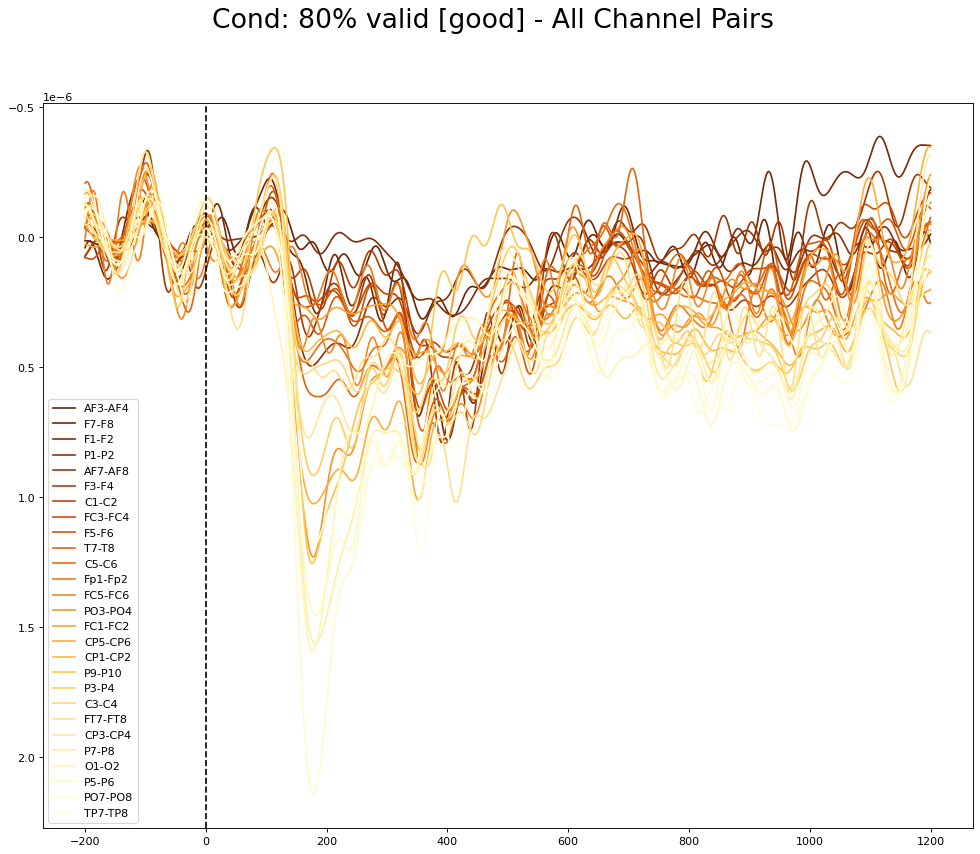

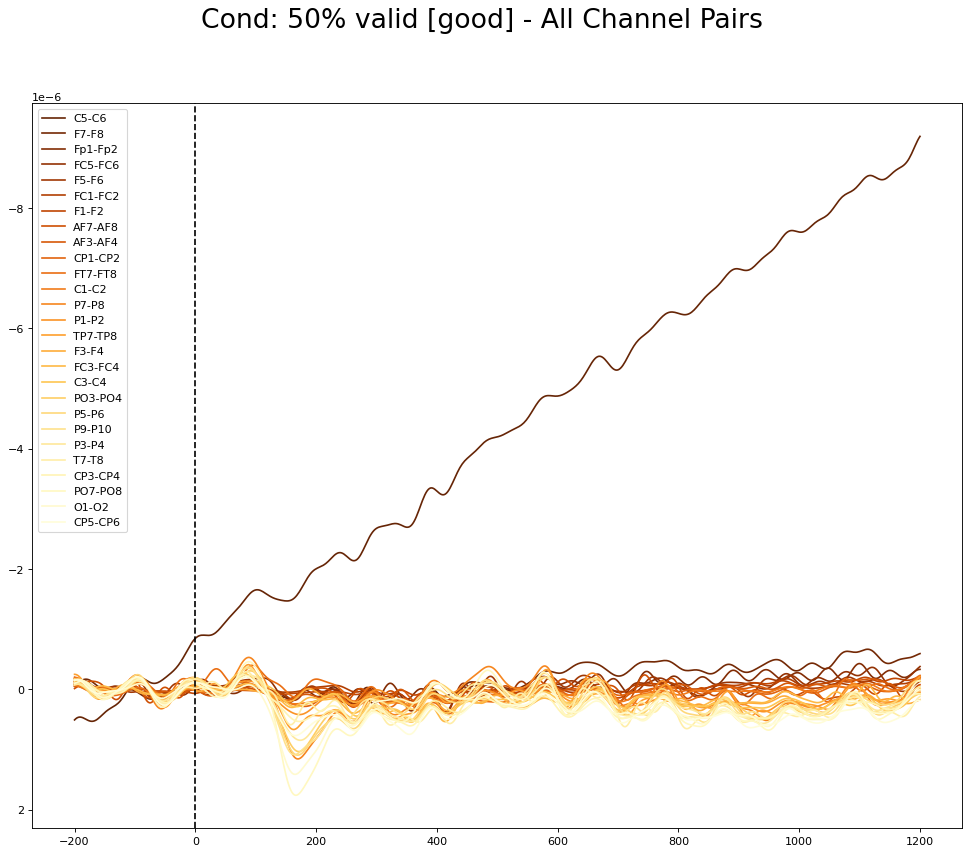

In [11]:
cmap = matplotlib.cm.get_cmap('YlOrBr')

for perf in ['good']: #perfs:
    for cond in conds:
        plt.figure(figsize=(15, 12), dpi=80)
        plt.suptitle("Cond: {} [{}] - All Channel Pairs".format(cond, perf), fontsize=24)

        ch_pair_mean_amp = [cda_all_channels[cond][perf][x].mean(0) for x in cda_all_channels[cond][perf]]
        mean_list, cda_sorted = zip(*sorted(zip(ch_pair_mean_amp, cda_all_channels[cond][perf].items())))

        nb_pairs = len(cda_all_channels[cond][perf].keys())
        for i, ch_pair in enumerate(cda_all_channels[cond][perf].keys()):
            plt.plot((times * 1000), cda_sorted[i][1], label=cda_sorted[i][0], color=cmap(1-i/nb_pairs))

        plt.axvline(x=0, color='k', linestyle='--')
        plt.gca().invert_yaxis()
        plt.legend()
        plt.show()

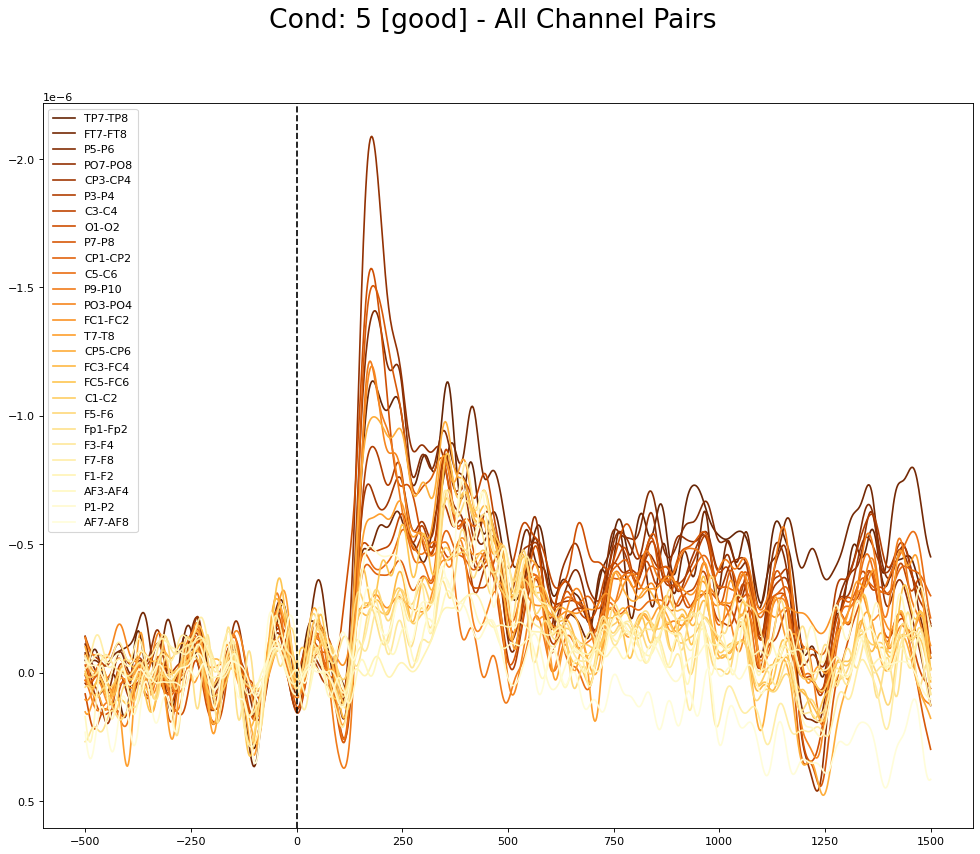

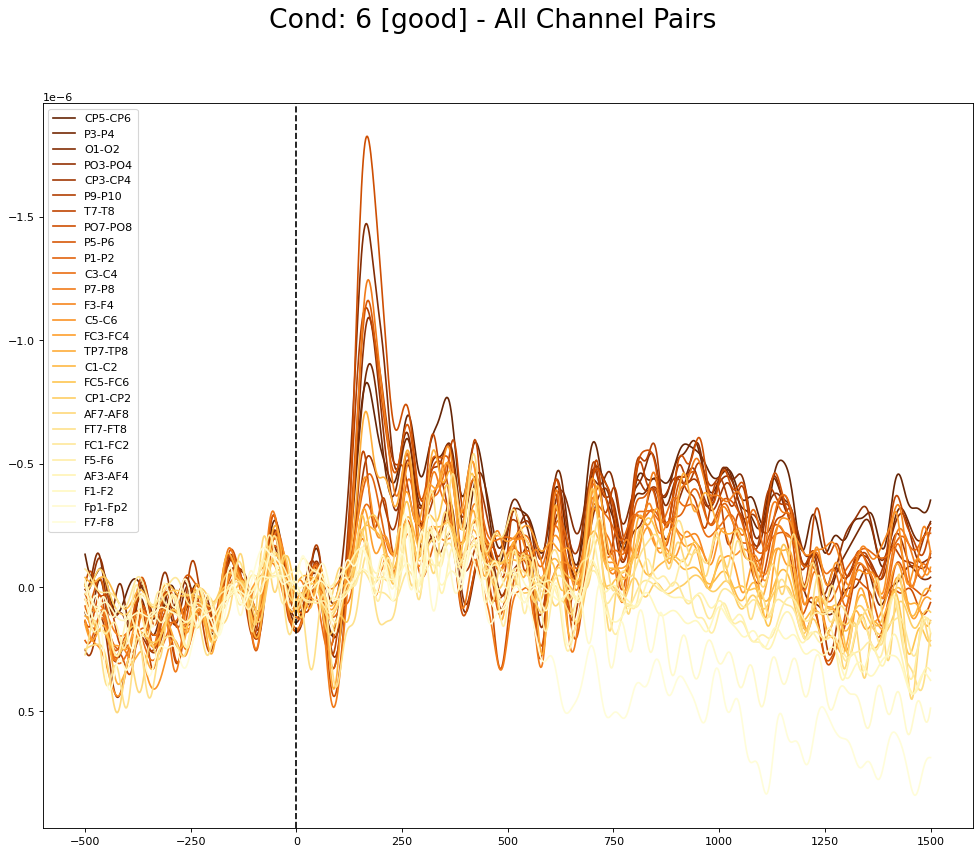

In [7]:
cmap = matplotlib.cm.get_cmap('YlOrBr')

for perf in ['good']: #perfs:
    for cond in conds:
        plt.figure(figsize=(15, 12), dpi=80)
        plt.suptitle("Cond: {} [{}] - All Channel Pairs".format(cond, perf), fontsize=24)

        ch_pair_mean_amp = [cda_all_channels[cond][perf][x].mean(0) for x in cda_all_channels[cond][perf]]
        mean_list, cda_sorted = zip(*sorted(zip(ch_pair_mean_amp, cda_all_channels[cond][perf].items())))

        nb_pairs = len(cda_all_channels[cond][perf].keys())
        for i, ch_pair in enumerate(cda_all_channels[cond][perf].keys()):
            plt.plot((times * 1000), cda_sorted[i][1], label=cda_sorted[i][0], color=cmap(1-i/nb_pairs))

        plt.axvline(x=0, color='k', linestyle='--')
        plt.gca().invert_yaxis()
        plt.legend()
        plt.show()

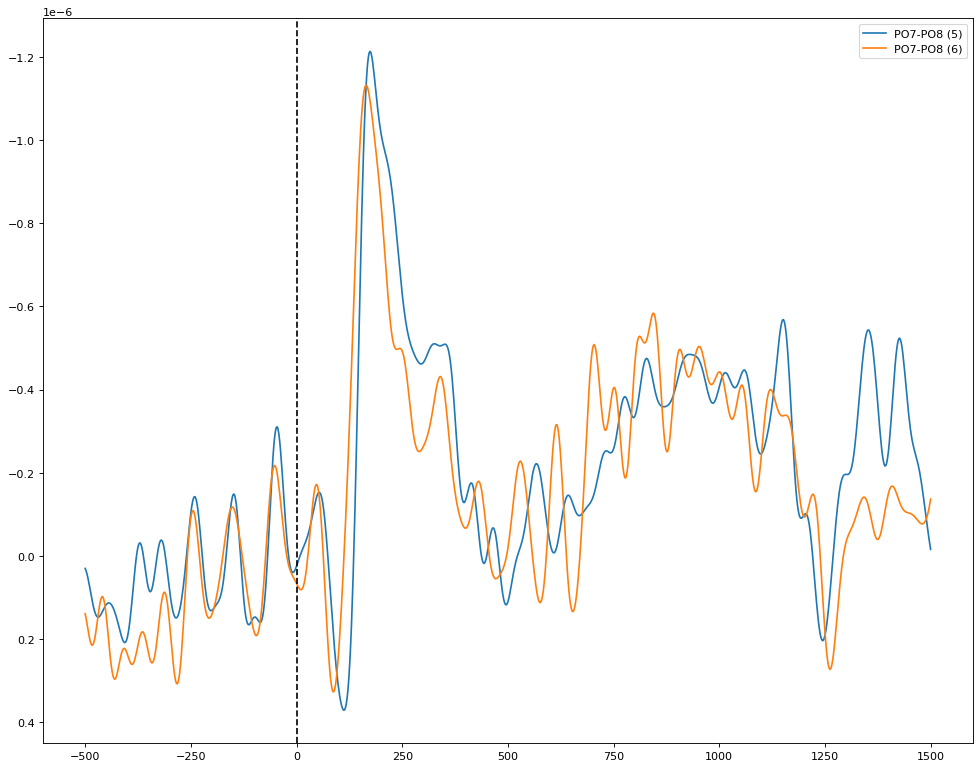

In [8]:
for perf in ['good']: #perfs:
    plt.figure(figsize=(15, 12), dpi=80)
    for cond in conds:
        plt.plot((times * 1000), cda_all_channels[cond][perf]['P9-P10'], label='PO7-PO8 ({})'.format(cond))#, color=cmap(1-i/nb_pairs))

    plt.axvline(x=0, color='k', linestyle='--')
    plt.gca().invert_yaxis()
    plt.legend()
    plt.show()

### 2.2 Plot CDA - All Channel Pairs (Subject Level / Per Subject)

==== SKIPPED: 0 points! (File: StratAtt_e2_LoadChans_pp11.set - Trigger: 5)
==== SKIPPED: 0 points! (File: StratAtt_e2_LoadChans_pp11.set - Trigger: 6)


/var/folders/gn/5c249d_15xb7y6sdl7n8cn9m0000gn/T/ipykernel_16146/3996435269.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(15, 12), dpi=80)


==== SKIPPED: 0 points! (File: StratAtt_e2_LoadChans_pp29.set - Trigger: 6)
==== SKIPPED: 0 points! (File: StratAtt_e2_LoadChans_pp24.set - Trigger: 6)
==== SKIPPED: 0 points! (File: StratAtt_e2_LoadChans_pp18.set - Trigger: 5)


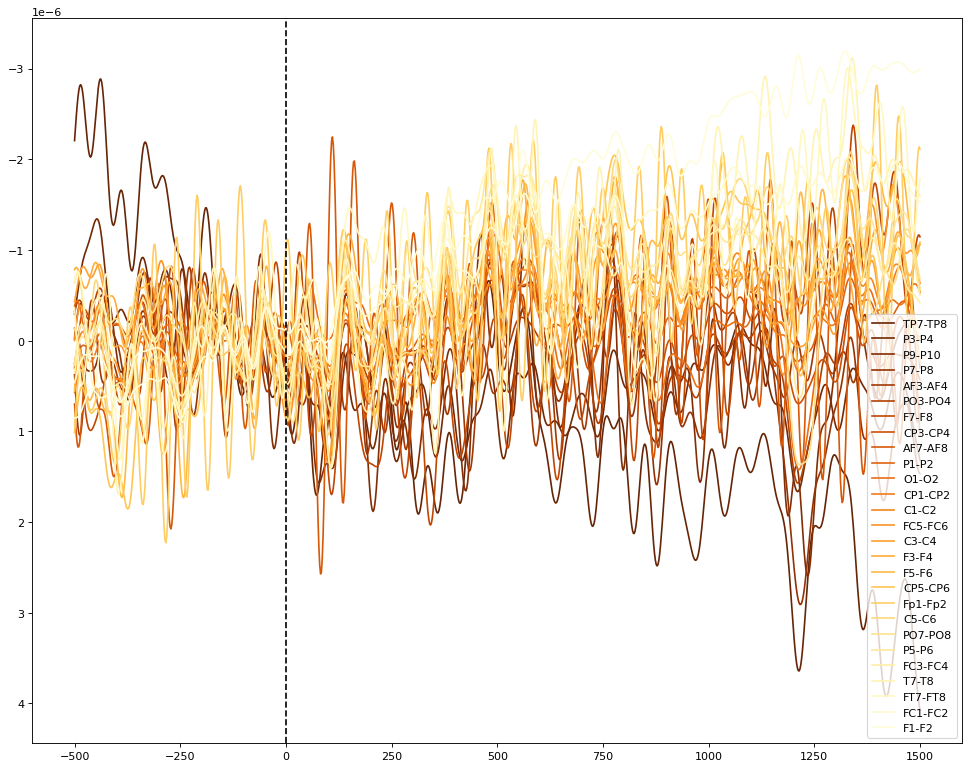

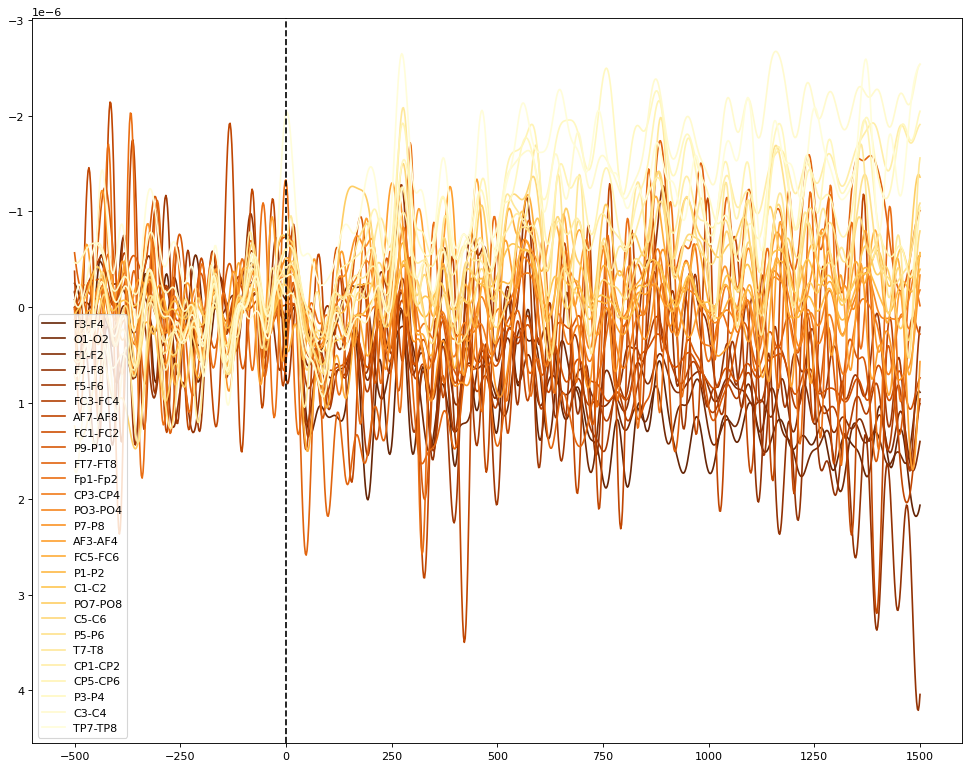

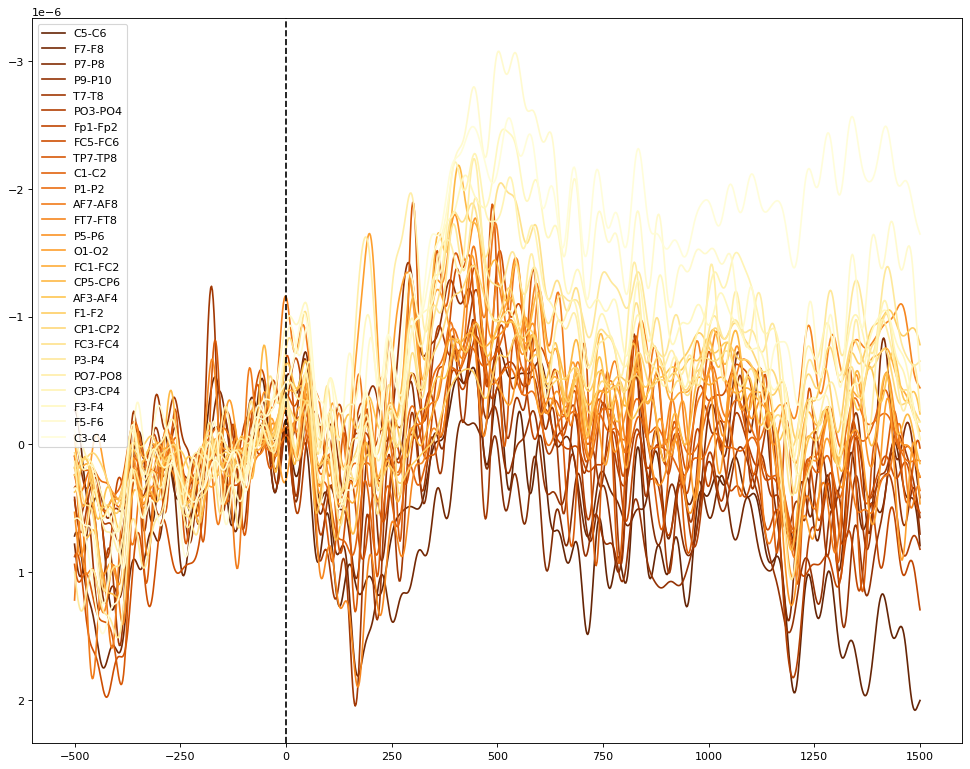

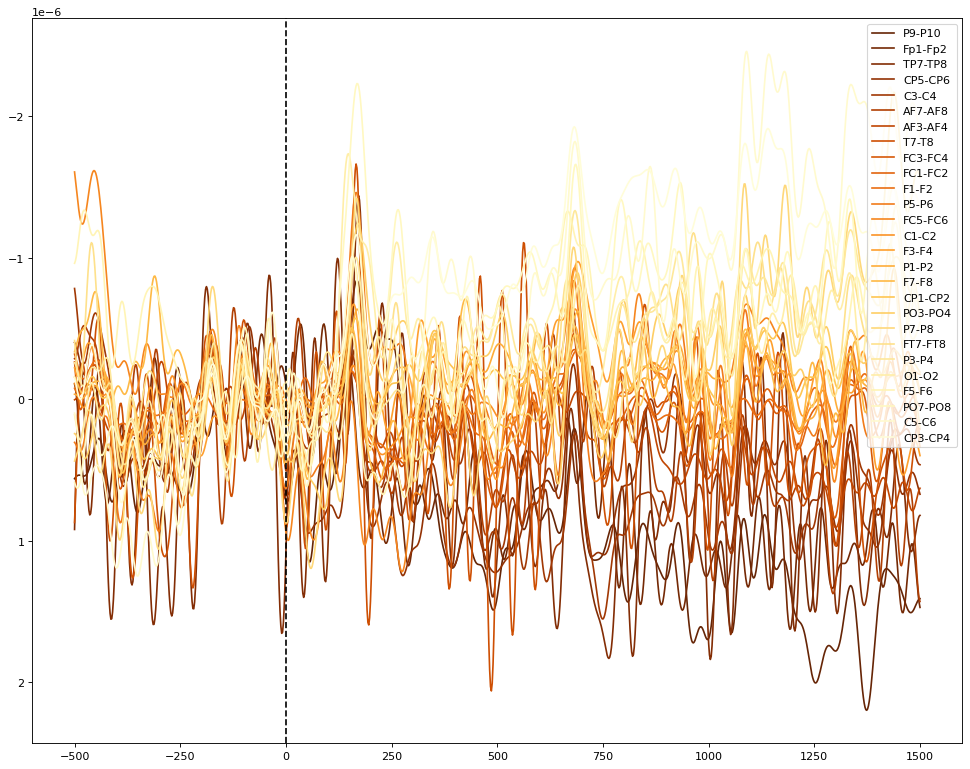

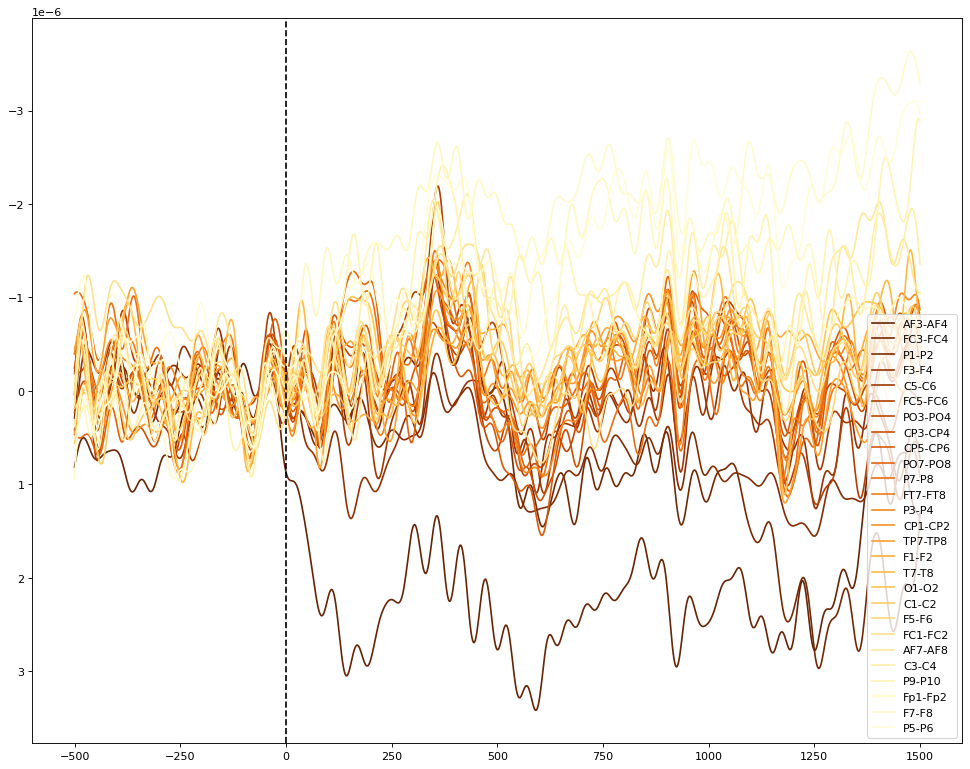

...

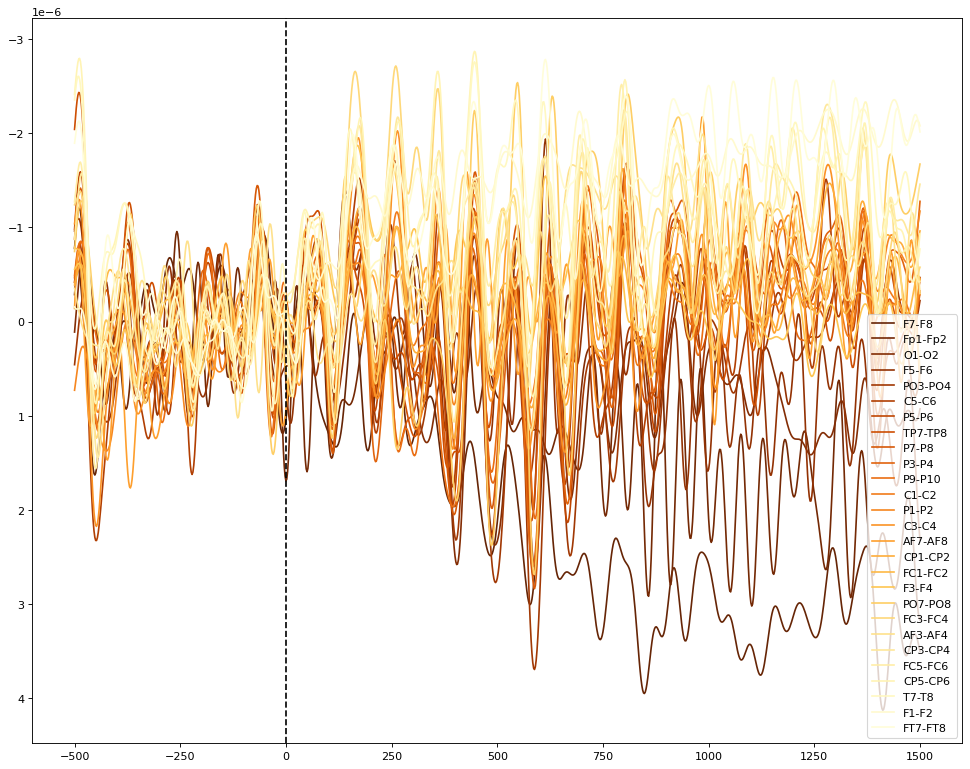

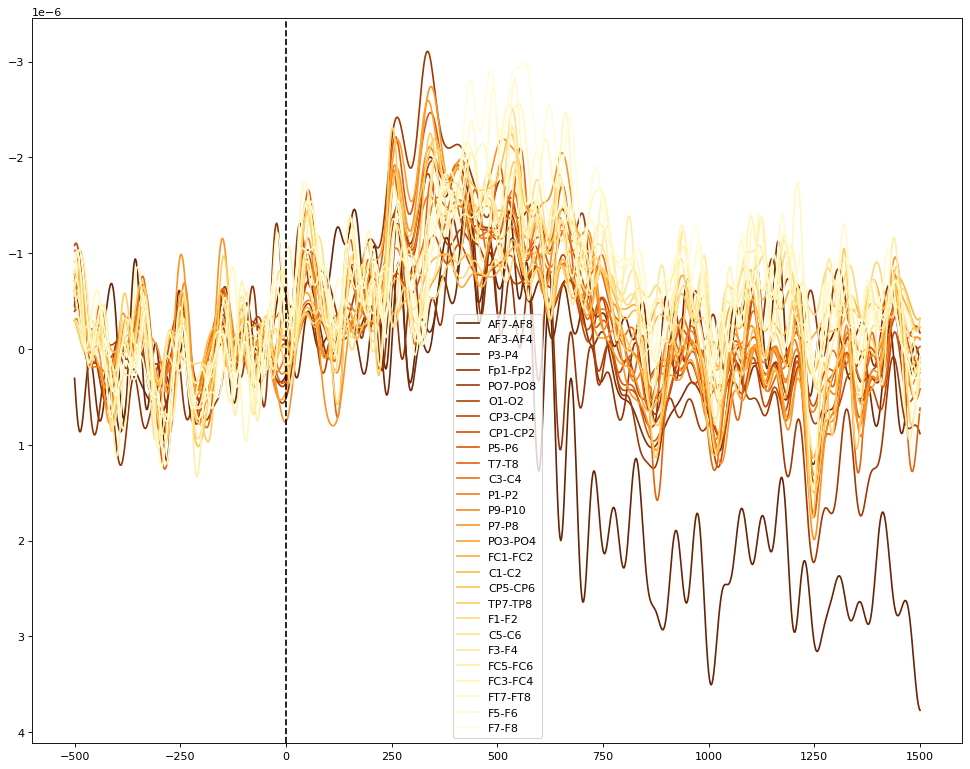

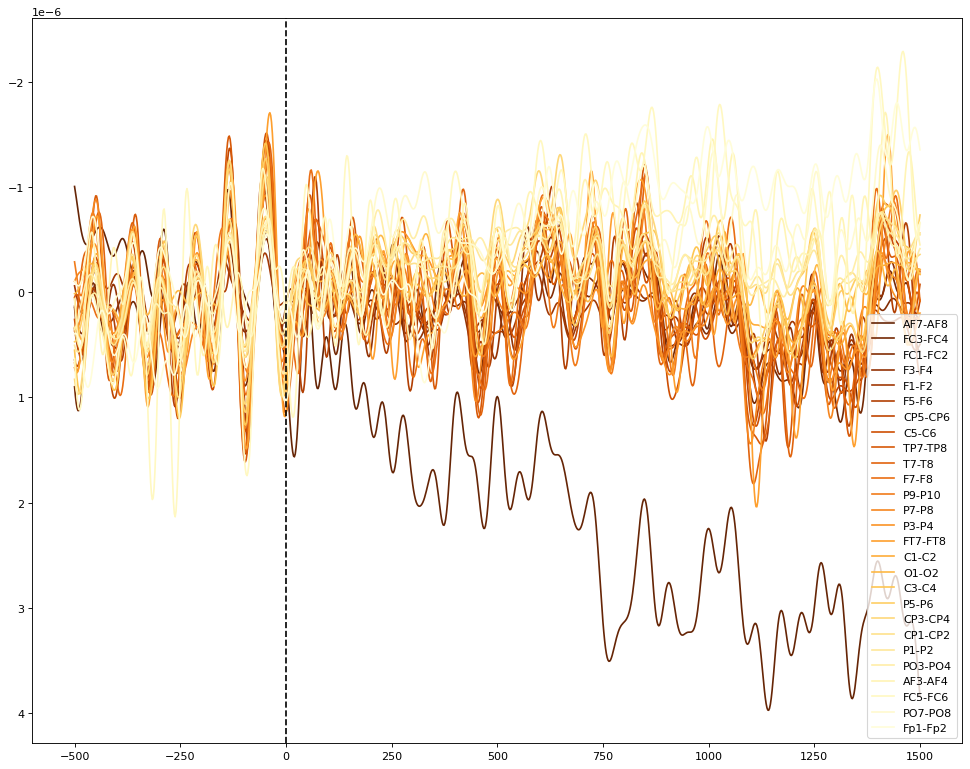

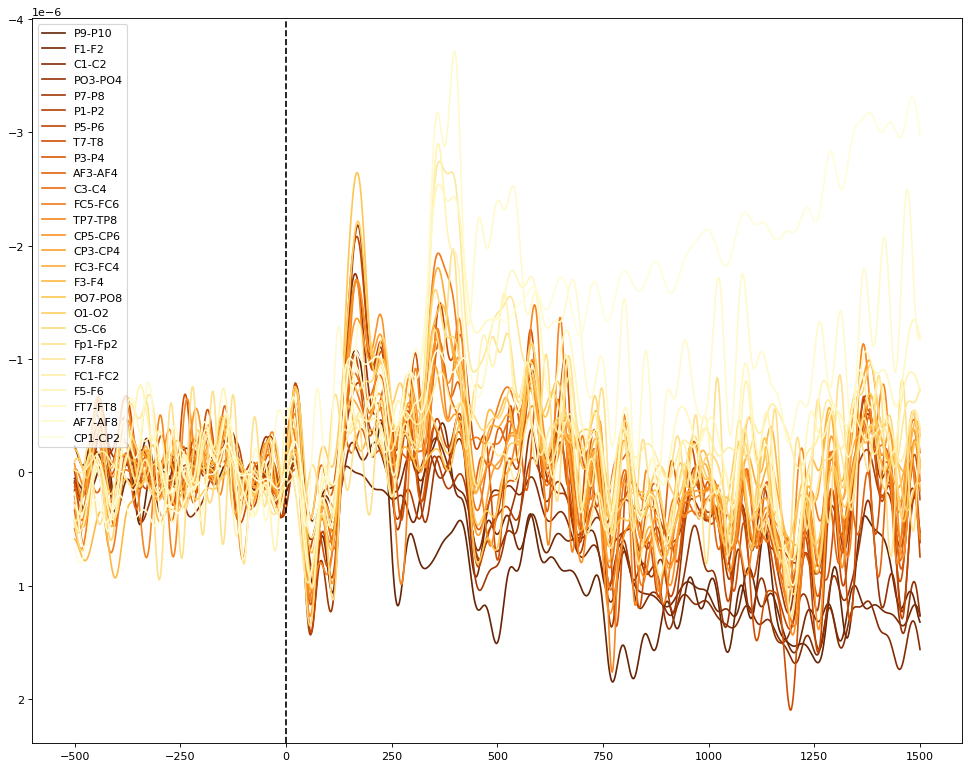

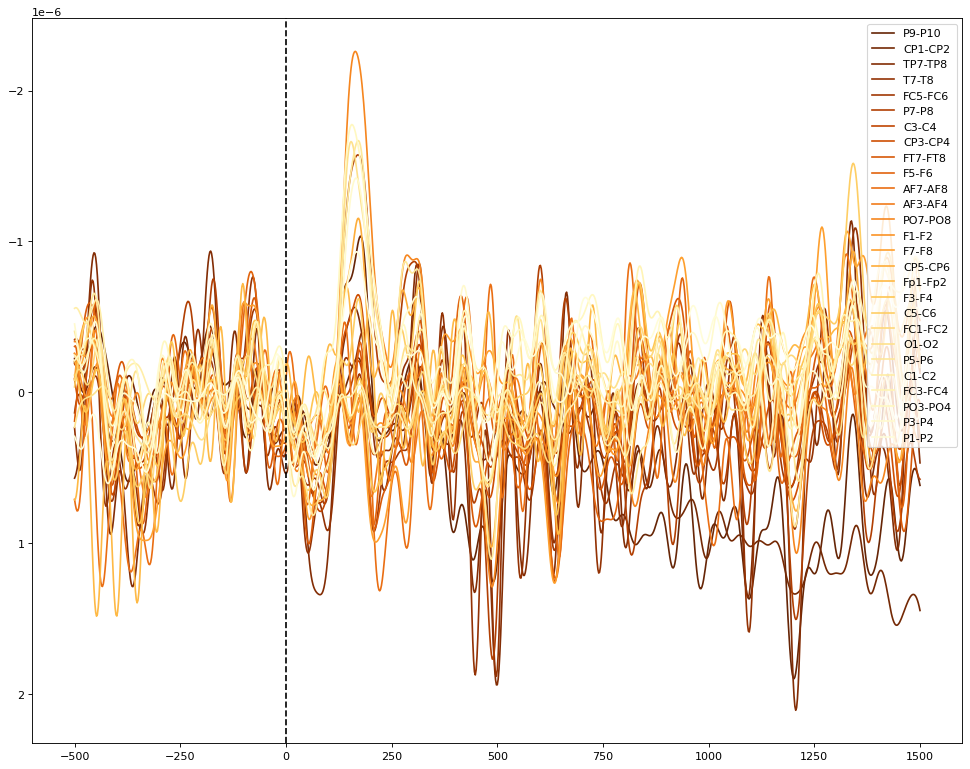

In [9]:
cmap = matplotlib.cm.get_cmap('YlOrBr')

for f in cda_all_channels_per_subj.keys():
    for perf in ['good']: #perfs:
        for cond in conds:        
            if len(cda_all_channels_per_subj[f][cond][perf]) > 0:
                plt.figure(figsize=(15, 12), dpi=80)

                ch_pair_mean_amp = [cda_all_channels_per_subj[f][cond][perf][x].mean(0) for x in cda_all_channels_per_subj[f][cond][perf]]
                mean_list, cda_sorted = zip(*sorted(zip(ch_pair_mean_amp, cda_all_channels_per_subj[f][cond][perf].items()), reverse=True))

                nb_pairs = len(cda_all_channels_per_subj[f][cond][perf].keys())
                for i, ch_pair in enumerate(cda_all_channels_per_subj[f][cond][perf].keys()):
                    plt.plot((times * 1000), cda_sorted[i][1], label=cda_sorted[i][0], color=cmap(1-i/nb_pairs))

                plt.axvline(x=0, color='k', linestyle='--')
                plt.gca().invert_yaxis()
                plt.legend()
                #plt.show()
                plt.savefig("./img/Gunseli2019-Channels-{}-{}-{}.jpg".format(f, cond, perf), dpi=300)
            else:
                print("==== SKIPPED: 0 points! (File: {} - Trigger: {})".format(str(f), cond))

### 3 Extra CDA - Midline

In [ ]:
chan_midline_all = ['Iz', 'Oz', 'POz', 'Pz', 'CPz', 'Fpz', 'AFz', 'Fz', 'FCz', 'Cz']

cda_midline_dict = dict()
cda_midline_channels = dict()
for cond in conds:
    cda_midline_channels[cond] = dict()
    for perf in perfs:
        cda_midline_channels[cond][perf] = dict()
    
for i, ch in enumerate(chan_midline_all):
    for file_name in epochs_all.keys():
        epochs_dict = epochs_all[file_name]
        cda_midline_dict[file_name] = dict()

        times = epochs_dict[conds[0]][sides[0]][perfs[0]].times

        for cur_cond in conds:
            cda_midline_dict[file_name][cur_cond] = dict()

            for cur_side in sides:
                cda_midline_dict[file_name][cur_cond][cur_side] = dict()

                for cur_perf in ['good']: #perfs:
                    if epochs_dict[cur_cond][cur_side][cur_perf] is not None:
                        epochs_midline = epochs_dict[cur_cond][cur_side][cur_perf].copy().pick_channels([chan_midline_all[i]])
                        evoked_midline = epochs_midline.average()
                        midline = evoked_midline.data.mean(0)

                        cda_midline_dict[file_name][cur_cond][cur_side][cur_perf] = midline
    
    cda_midline_all = dict()

    for cond in cda_midline_dict[list(cda_midline_dict.keys())[0]].keys():
        cda_midline_all[cond] = dict()
        
        for perf in ['good']: #perfs:
            cda_midline_all[cond][perf] = dict()

            for f in cda_dict.keys():
                if (f == 'StratAtt_e2_LoadChans_pp11.set') or (f == 'StratAtt_e2_LoadChans_pp18.set' and cond == '5') or (f == 'StratAtt_e2_LoadChans_pp24.set' and cond == '6') or (f == 'StratAtt_e2_LoadChans_pp29.set' and cond == '6'):
                    continue
                    
                if len(cda_midline_dict[f][cond]['left'][perf]) > 0:
                    cda_dict_cur = (cda_midline_dict[f][cond]['left'][perf] + cda_midline_dict[f][cond]['right'][perf])/2
                    cda_midline_all[cond][perf] = np.vstack([cda_midline_all[cond][perf], cda_dict_cur]) if len(cda_midline_all[cond][perf]) else cda_dict_cur
                else:
                    print("==== SKIPPED: 0 points! (File: {} - Cond: {} - Perf: {})".format(str(f), str(cond), perf))
        
            cda_midline_channels[cond][perf]["{}".format(chan_midline_all[i])] = cda_midline_all[cond][perf].mean(0)

# Plot
cmap = matplotlib.cm.get_cmap('YlOrBr')

for perf in ['good']: #perfs:
    for cond in conds:
        plt.figure(figsize=(15, 12), dpi=80)
        plt.suptitle("Cond: {} [{}] - All Channel Pairs".format(cond, perf), fontsize=24)

        ch_pair_mean_amp = [cda_midline_channels[cond][perf][x].mean(0) for x in cda_midline_channels[cond][perf]]
        mean_list, cda_sorted = zip(*sorted(zip(ch_pair_mean_amp, cda_midline_channels[cond][perf].items()), reverse=True))

        nb_pairs = len(cda_midline_channels[cond][perf].keys())
        for i, ch_pair in enumerate(cda_midline_channels[cond][perf].keys()):
            plt.plot((times * 1000), cda_sorted[i][1], label=cda_sorted[i][0], color=cmap(1-i/nb_pairs))

        plt.axvline(x=0, color='k', linestyle='--')
        plt.gca().invert_yaxis()
        plt.legend()
        #plt.show()
        plt.savefig("./img/Gunseli2019-Channels-Midline-{}-{}.jpg".format(cond, perf), dpi=300)
